Reading file: C:\Users\Alexis\Documents\predictive-maintenance-of-hydraulic-systems\Data\CE.txt
    col_0   col_1   col_2   col_3   col_4   col_5   col_6   col_7   col_8  \
0  47.202  47.273  47.250  47.332  47.213  47.372  47.273  47.438  46.691   
1  29.208  28.822  28.805  28.922  28.591  28.643  28.216  27.812  27.514   
2  23.554  23.521  23.527  23.008  23.042  23.052  22.658  22.952  22.908   
3  21.540  21.419  21.565  20.857  21.052  21.039  20.926  20.912  20.989   
4  20.460  20.298  20.350  19.867  19.997  19.972  19.924  19.813  19.691   

    col_9  ...  col_50  col_51  col_52  col_53  col_54  col_55  col_56  \
0  46.599  ...  31.554  30.953  30.639  30.561  30.368  30.224  29.790   
1  27.481  ...  23.995  24.328  24.283  23.877  23.816  23.933  23.354   
2  22.359  ...  21.711  21.564  21.564  21.526  21.753  21.749  21.802   
3  20.882  ...  20.687  20.703  20.295  20.482  20.600  20.547  20.708   
4  19.634  ...  19.887  19.919  19.696  19.634  19.747  20.005  19.919 

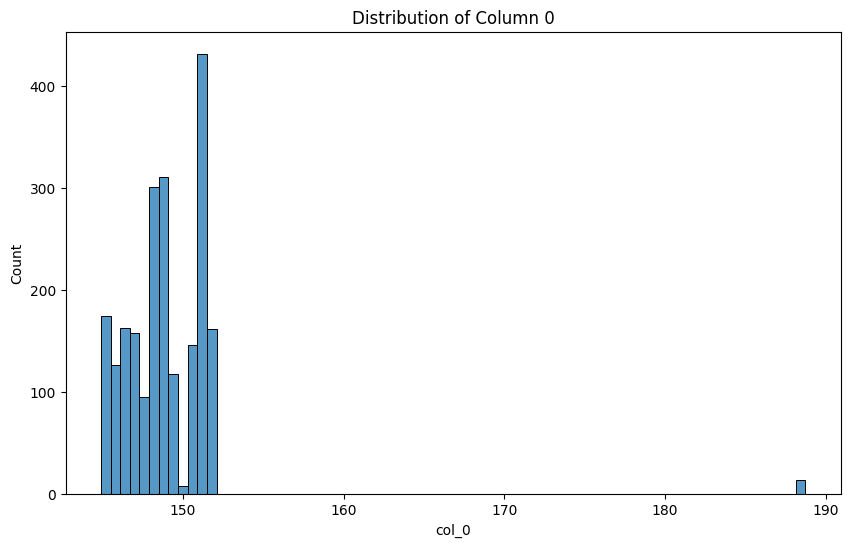

Index(['col_0', 'col_1', 'col_2', 'col_3', 'col_4', 'col_5', 'col_6', 'col_7',
       'col_8', 'col_9', 'col_10', 'col_11', 'col_12', 'col_13', 'col_14',
       'col_15', 'col_16', 'col_17', 'col_18', 'col_19', 'col_20', 'col_21',
       'col_22', 'col_23', 'col_24', 'col_25', 'col_26', 'col_27', 'col_28',
       'col_29', 'col_30', 'col_31', 'col_32', 'col_33', 'col_34', 'col_35',
       'col_36', 'col_37', 'col_38', 'col_39', 'col_40', 'col_41', 'col_42',
       'col_43', 'col_44', 'col_45', 'col_46', 'col_47', 'col_48', 'col_49',
       'col_50', 'col_51', 'col_52', 'col_53', 'col_54', 'col_55', 'col_56',
       'col_57', 'col_58', 'col_59', 'Cooler_Condition', 'Valve_Condition',
       'Pump_Leakage', 'Accumulator_Pressure', 'Stable_Flag'],
      dtype='object')
(2205, 65)
    col_0   col_1   col_2   col_3   col_4   col_5   col_6   col_7   col_8  \
0  151.12  151.09  151.16  151.22  151.16  151.11  151.19  151.24  151.16   
1  150.84  150.92  150.82  150.77  150.86  150.80  150.82 

In [16]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns

# Define directory path
data_dir = r"C:\Users\Alexis\Documents\predictive-maintenance-of-hydraulic-systems\Data"

# Initialize sensor dictionary
sensor_data = {}

# Read each file and combine them
for filename in os.listdir(data_dir):
    if filename.endswith('.txt') and 'description' not in filename.lower() and 'documentation' not in filename.lower():
        sensor_type = filename.split('.')[0]
        filepath = os.path.join(data_dir, filename)
        
        print(f"Reading file: {filepath}")  # Print file being processed
        
        # Load the data, assuming no header and providing default column names
        df = pd.read_csv(filepath, delimiter='\t', header=None, 
                         names=[f"col_{i}" for i in range(60)], encoding="ISO-8859-1")  # Example assumes 60 columns

        print(df.head())  # Print the first few rows of the dataframe
        
        if sensor_type not in sensor_data:
            sensor_data[sensor_type] = df
        else:
            sensor_data[sensor_type] = pd.concat([sensor_data[sensor_type], df])

# Now load the failure condition data
profile_path = os.path.join(data_dir, 'profile.txt')
profile_data = pd.read_csv(profile_path, delimiter='\t', header=None)

# Add column names for the failure conditions
profile_data.columns = ['Cooler_Condition', 'Valve_Condition', 'Pump_Leakage', 'Accumulator_Pressure', 'Stable_Flag']

# Example: use PS1 as the sensor data (could extend to other sensors)
pressure_data = sensor_data.get('PS1')

# Example of preprocessing
def preprocess_data(df):
    df.dropna(inplace=True)  # Remove missing values
    return df

# Apply preprocessing to the pressure data
if pressure_data is not None:
    pressure_data = preprocess_data(pressure_data)

    # Combine with failure condition data (assuming both have the same length/indices)
    if len(pressure_data) == len(profile_data):
        pressure_data = pressure_data.reset_index(drop=True)  # Reset index to ensure proper merge
        pressure_data = pd.concat([pressure_data, profile_data], axis=1)
    else:
        print("Mismatch in length between sensor data and profile data")

    # Check the combined data
    print(pressure_data.head())

    # Visualize one column (col_0) from sensor data
    plt.figure(figsize=(10, 6))
    sns.histplot(pressure_data['col_0'])  # Replace 'col_0' with an actual column name
    plt.title('Distribution of Column 0')
    plt.show()

    # Print sensor data and failure conditions
    print(pressure_data.columns)
    print(pressure_data.shape)
    print(pressure_data.head())
else:
    print("No data found for PS1 sensor")


In [25]:
# Print the columns of PS1 data to understand the structure
df = sensor_data['PS1']
print(df.columns)

# Load the profile.txt file which should contain the failure conditions
profile_filepath = os.path.join(data_dir, 'profile.txt')

# Assuming the profile.txt is tab-delimited and has no header
profile_df = pd.read_csv(profile_filepath, delimiter='\t', header=None, 
                         names=['Cooler', 'Valve', 'Pump_Leakage', 'Accumulator', 'Stable_Flag'])

print(profile_df.head())  # Print first few rows to check if it loaded correctly

# Reset the index of both dataframes to align them properly
sensor_data['PS1'].reset_index(drop=True, inplace=True)
profile_df.reset_index(drop=True, inplace=True)

# Now merge the profile data with the PS1 sensor data
df_merged = pd.concat([sensor_data['PS1'], profile_df], axis=1)

# Print the merged dataframe to check if the data aligns properly
print(df_merged.head())



Index(['col_0', 'col_1', 'col_2', 'col_3', 'col_4', 'col_5', 'col_6', 'col_7',
       'col_8', 'col_9', 'col_10', 'col_11', 'col_12', 'col_13', 'col_14',
       'col_15', 'col_16', 'col_17', 'col_18', 'col_19', 'col_20', 'col_21',
       'col_22', 'col_23', 'col_24', 'col_25', 'col_26', 'col_27', 'col_28',
       'col_29', 'col_30', 'col_31', 'col_32', 'col_33', 'col_34', 'col_35',
       'col_36', 'col_37', 'col_38', 'col_39', 'col_40', 'col_41', 'col_42',
       'col_43', 'col_44', 'col_45', 'col_46', 'col_47', 'col_48', 'col_49',
       'col_50', 'col_51', 'col_52', 'col_53', 'col_54', 'col_55', 'col_56',
       'col_57', 'col_58', 'col_59'],
      dtype='object')
   Cooler  Valve  Pump_Leakage  Accumulator  Stable_Flag
0       3    100             0          130            1
1       3    100             0          130            1
2       3    100             0          130            1
3       3    100             0          130            1
4       3    100             0         

In [27]:
import pandas as pd
import os
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler


# Step 1: Load condition annotations from profile.txt
profile_path = os.path.join(data_dir, 'profile.txt')

# Load profile.txt data
condition_columns = ['Cooler', 'Valve', 'Pump_Leakage', 'Accumulator', 'Stable_Flag']
profile_df = pd.read_csv(profile_path, delimiter='\t', names=condition_columns)

print(profile_df.head())  # Check the first few rows of the profile data

# Step 2: Reset the index for merging (we want to align rows properly)
df = sensor_data['PS1'].reset_index(drop=True)

# Merge sensor data with condition data
df = pd.concat([df, profile_df], axis=1)

# Check the combined data
print(df.head())  # Make sure the merged data looks good

# Step 3: Feature Selection and Target Variable
# Drop non-feature columns (e.g., 'Cooler' will be our target)
X = df.drop(columns=['Cooler', 'Valve', 'Pump_Leakage', 'Accumulator', 'Stable_Flag'])

# Target: Predicting failures (Cooler condition as an example)
y = df['Cooler'].apply(lambda x: 1 if x < 100 else 0)  # 1 indicates failure (cooler below 100%), 0 is healthy

# Step 4: Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Step 5: Scale features (helps some models perform better)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Output the shape of the training and test data
print(f"Training data shape: {X_train_scaled.shape}")
print(f"Test data shape: {X_test_scaled.shape}")


   Cooler  Valve  Pump_Leakage  Accumulator  Stable_Flag
0       3    100             0          130            1
1       3    100             0          130            1
2       3    100             0          130            1
3       3    100             0          130            1
4       3    100             0          130            1
    col_0   col_1   col_2   col_3   col_4   col_5   col_6   col_7   col_8  \
0  151.12  151.09  151.16  151.22  151.16  151.11  151.19  151.24  151.16   
1  150.84  150.92  150.82  150.77  150.86  150.80  150.82  150.93  150.88   
2  150.57  150.60  150.47  150.44  150.44  150.43  150.52  150.62  150.52   
3  150.27  150.31  150.34  150.26  150.28  150.33  150.31  150.31  150.35   
4  150.01  150.09  150.15  150.13  150.17  150.19  150.12  150.16  150.31   

    col_9  ...  col_55  col_56  col_57  col_58  col_59  Cooler  Valve  \
0  151.17  ...  151.16  151.14  151.10  151.21  151.19       3    100   
1  150.78  ...  150.79  150.84  150.79  150.80  1

In [29]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# We already have sensor_data['PS1'] loaded and the profile data merged

# Drop non-feature columns (the target and other non-sensor-related columns)
X = df.drop(columns=['Cooler', 'Valve', 'Pump_Leakage', 'Accumulator', 'Stable_Flag'])

# Target: Predicting cooler failures (1 if cooler < 100, otherwise 0)
y = df['Cooler'].apply(lambda x: 1 if x < 100 else 0)

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize the Logistic Regression model
log_reg = LogisticRegression()

# Train the model
log_reg.fit(X_train_scaled, y_train)

# Predict the test set results
y_pred = log_reg.predict(X_test_scaled)

# Evaluate the model's performance
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f"Model Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)


Model Accuracy: 99.09%
Confusion Matrix:
[[220   2]
 [  4 436]]
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99       222
           1       1.00      0.99      0.99       440

    accuracy                           0.99       662
   macro avg       0.99      0.99      0.99       662
weighted avg       0.99      0.99      0.99       662

